<a href="https://colab.research.google.com/github/balakumar4/Credit-Model-Scoring-/blob/main/Credit_Scoring_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [22]:
# Upload kaggle.json
from google.colab import files
files.upload()  # Upload your kaggle.json when prompted


Saving archive (2).zip to archive (2).zip


{'archive (2).zip': b'PK\x03\x04-\x00\x00\x00\x08\x00\xe1s\xd6T\xb0A\xfdH\xff\xff\xff\xff\xff\xff\xff\xff\x08\x00\x14\x00test.csv\x01\x00\x10\x00Vy\xea\x00\x00\x00\x00\x00\xac\xcb6\x00\x00\x00\x00\x00\xe4\xbdYs\x1c\xc9\xd5%\xf8>\xbf\x82\xcd\x9e\x9e\x87\xb1\xc80\xdf\xae/o]\x9b>I-\x96d*\xb5\xc9\xbe~IK$\x12E\xa8@\x80\x1f\x00\x96D\xfd\xfa9\xc7c\xf3\x88\x8c\xc8H\xee`\r%U\xa9X\x04\x90~\xfc\xfa\xdd\xef\xb9\x7f\xf8\xbe\xfa\xee\xcd\xc3\xe3\xdd\xab\xc3\xfd\x16\xff\xff\xc5\xdd\xed\xe3\xcb\xea\xc7\xdd\xabC\xf5\xcd\xcf\x87\xea\xa7\x9f~\xac\xfe\xbc\xdf\xbfy\xbd{\xbc\xbe\xbb\xad\xbe\xb9\xbd}\xb3\xbb\xd9\xfe\xe1v\x8f?\xdf\xfc\xd9\x9b\xb7\xf8\xc7\x97\xbb\xdb\xcb\xedO\xbb\x9b\xdd\xfd\xdb\xea\xc77\xaf\xb6\xdf\xeen\x7f\xd9~\xb3\xdf\xdf\xbd\xb9}|\xc8\xbf\xf3\xdd\xfd\xe1\xf2\xfaq\xfb\xdd\xee\xfe\xb2\xfa\xc3\xed\xe3\xe1\xfe\xf0\xf0\xb8\xfd\xeb\xee\xf1\x90\xff\xed\xdd\xd5\xf6Ow\xbb\xdb\xeaoo_\x1f\xfa\x7f\xf8\xfep\xb3{\xbb\xbd\xba\xbf{\xb5\xbd|s\xd8^\x16\x7f8\xff\xab\xc3\xe5\xf6/\xbb\xb7\xaf\x0e\xb7\x8f\xd5w\x

In [23]:
# Set up Kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json


cp: cannot stat 'kaggle.json': No such file or directory
chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [24]:
# Download the dataset (replace with exact dataset slug if needed)
!kaggle datasets download -d jainshubham90/credit-score-classification


Traceback (most recent call last):
  File "/usr/local/bin/kaggle", line 10, in <module>
    sys.exit(main())
             ^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/kaggle/cli.py", line 68, in main
    out = args.func(**command_args)
          ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/kaggle/api/kaggle_api_extended.py", line 1741, in dataset_download_cli
    with self.build_kaggle_client() as kaggle:
         ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/kaggle/api/kaggle_api_extended.py", line 688, in build_kaggle_client
    username=self.config_values['username'],
             ~~~~~~~~~~~~~~~~~~^^^^^^^^^^^^
KeyError: 'username'


In [26]:
!kaggle datasets download -d jainshubham90/credit-score-classification


Traceback (most recent call last):
  File "/usr/local/bin/kaggle", line 10, in <module>
    sys.exit(main())
             ^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/kaggle/cli.py", line 68, in main
    out = args.func(**command_args)
          ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/kaggle/api/kaggle_api_extended.py", line 1741, in dataset_download_cli
    with self.build_kaggle_client() as kaggle:
         ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/kaggle/api/kaggle_api_extended.py", line 688, in build_kaggle_client
    username=self.config_values['username'],
             ~~~~~~~~~~~~~~~~~~^^^^^^^^^^^^
KeyError: 'username'


In [27]:
!ls


'archive (2).zip'   german_credit_data.csv   sample_data


In [28]:
import zipfile

with zipfile.ZipFile("archive (2).zip", 'r') as zip_ref:
    zip_ref.extractall("credit_score_data")


In [29]:
!mv "archive (2).zip" credit_dataset.zip


In [30]:
with zipfile.ZipFile("credit_dataset.zip", 'r') as zip_ref:
    zip_ref.extractall("credit_score_data")


In [31]:
!ls credit_score_data


test.csv  train.csv


In [32]:
import pandas as pd

# Load train and test datasets
train_df = pd.read_csv("credit_score_data/train.csv")
test_df = pd.read_csv("credit_score_data/test.csv")

# Show sample data
train_df.head()


/tmp/ipython-input-1317451550.py:4: DtypeWarning: Columns (26) have mixed types. Specify dtype option on import or set low_memory=False.
  train_df = pd.read_csv("credit_score_data/train.csv")


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,0x1602,CUS_0xd40,January,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,_,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.41529543900253,High_spent_Small_value_payments,312.49408867943663,Good
1,0x1603,CUS_0xd40,February,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.944960,NaN,No,49.574949,118.28022162236736,Low_spent_Large_value_payments,284.62916249607184,Good
2,0x1604,CUS_0xd40,March,Aaron Maashoh,-500,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521264648,Low_spent_Medium_value_payments,331.2098628537912,Good
3,0x1605,CUS_0xd40,April,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.4580743910713,Low_spent_Small_value_payments,223.45130972736786,Good
4,0x1606,CUS_0xd40,May,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153086217326,High_spent_Medium_value_payments,341.48923103222177,Good


In [33]:
# Check for missing values
print(train_df.isnull().sum())

# Check data types
print(train_df.dtypes)

# Check target column (usually "Credit_Score" or similar)
print(train_df.columns)


ID                              0
Customer_ID                     0
Month                           0
Name                         9985
Age                             0
SSN                             0
Occupation                      0
Annual_Income                   0
Monthly_Inhand_Salary       15002
Num_Bank_Accounts               0
Num_Credit_Card                 0
Interest_Rate                   0
Num_of_Loan                     0
Type_of_Loan                11408
Delay_from_due_date             0
Num_of_Delayed_Payment       7002
Changed_Credit_Limit            0
Num_Credit_Inquiries         1965
Credit_Mix                      0
Outstanding_Debt                0
Credit_Utilization_Ratio        0
Credit_History_Age           9030
Payment_of_Min_Amount           0
Total_EMI_per_month             0
Amount_invested_monthly      4479
Payment_Behaviour               0
Monthly_Balance              1200
Credit_Score                    0
dtype: int64
ID                           object

In [37]:
# Safe encoding for all object-type columns except the target
for col in train_df.select_dtypes(include='object').columns:
    if col != "Credit_Score":  # Skip target
        # Create a mapping of unique values in training data
        unique_vals = train_df[col].unique()
        val_map = {val: idx for idx, val in enumerate(unique_vals)}

        # Apply mapping to train and test data
        train_df[col] = train_df[col].map(val_map)
        test_df[col] = test_df[col].map(val_map)

        # Fill unknown values in test with -1
        test_df[col] = test_df[col].fillna(-1)


In [39]:
print(test_df.columns)


Index(['ID', 'Customer_ID', 'Month', 'Name', 'Age', 'SSN', 'Occupation',
       'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
       'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan', 'Type_of_Loan',
       'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Credit_Mix', 'Outstanding_Debt',
       'Credit_Utilization_Ratio', 'Credit_History_Age',
       'Payment_of_Min_Amount', 'Total_EMI_per_month',
       'Amount_invested_monthly', 'Payment_Behaviour', 'Monthly_Balance'],
      dtype='object')


In [40]:
from sklearn.model_selection import train_test_split

X = train_df.drop("Credit_Score", axis=1)
y = train_df["Credit_Score"]

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)


In [41]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report

clf = RandomForestClassifier()
clf.fit(X_train, y_train)

y_pred = clf.predict(X_val)
print("Validation Accuracy:", accuracy_score(y_val, y_pred))
print(classification_report(y_val, y_pred))


Validation Accuracy: 0.79135
              precision    recall  f1-score   support

        Good       0.77      0.73      0.75      3527
        Poor       0.78      0.80      0.79      5874
    Standard       0.80      0.81      0.81     10599

    accuracy                           0.79     20000
   macro avg       0.79      0.78      0.78     20000
weighted avg       0.79      0.79      0.79     20000



In [43]:
test_df.select_dtypes(include='object').columns


Index(['ID', 'Month', 'Age'], dtype='object')

In [44]:
for col in test_df.select_dtypes(include='object').columns:
    print(f"\n{col}:")
    print(test_df[col].unique()[:10])  # show first 10 unique values



ID:
['0x160a' '0x160b' '0x160c' '0x160d' '0x1616' '0x1617' '0x1618' '0x1619'
 '0x1622' '0x1623']

Month:
['September' 'October' 'November' 'December']

Age:
['23' '24' '24_' '28' '35' '55' '22' '31' '32' '1694']


In [45]:
# Remove ₹ or any other symbols and convert to float
test_df["Amount_invested_monthly"] = (
    test_df["Amount_invested_monthly"]
    .replace({'₹': '', ',': ''}, regex=True)
    .astype(float)
)


In [46]:
for col in test_df.select_dtypes(include='object').columns:
    if col in train_df.columns:
        if train_df[col].dtype == 'object':
            # Build map from training data
            val_map = {v: i for i, v in enumerate(train_df[col].unique())}
            test_df[col] = test_df[col].map(val_map).fillna(-1)


In [48]:
# Fix non-numeric/categorical columns in test set to match training set

for col in test_df.columns:
    # If the column exists in train_df and is object-type in either set
    if col in train_df.columns and (
        train_df[col].dtype == 'object' or test_df[col].dtype == 'object'
    ):
        # Create a mapping from train set
        mapping = {val: idx for idx, val in enumerate(train_df[col].unique())}

        # Map values in both train and test
        test_df[col] = test_df[col].map(mapping)

        # Fill unseen or unknown values with -1
        test_df[col] = test_df[col].fillna(-1)

# Try to convert all columns to numeric (just in case)
test_df = test_df.apply(pd.to_numeric, errors='coerce').fillna(-1)


In [49]:
X_test = test_df.copy()
test_predictions = clf.predict(X_test)
print(test_predictions[:10])


['Good' 'Good' 'Good' 'Good' 'Good' 'Good' 'Good' 'Good' 'Good' 'Good']


In [50]:
# Create a DataFrame with predictions and customer IDs
output_df = pd.DataFrame({
    "Customer_ID": test_df["Customer_ID"],  # Use original ID column
    "Predicted_Credit_Score": test_predictions
})

# Show the first few rows
output_df.head()


,Customer_ID,Predicted_Credit_Score
0,12320,Good
1,12320,Good
2,12320,Good
3,12320,Good
4,1066,Good


In [51]:
output_df.to_csv("credit_score_predictions.csv", index=False)


In [52]:
from google.colab import files
files.download("credit_score_predictions.csv")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

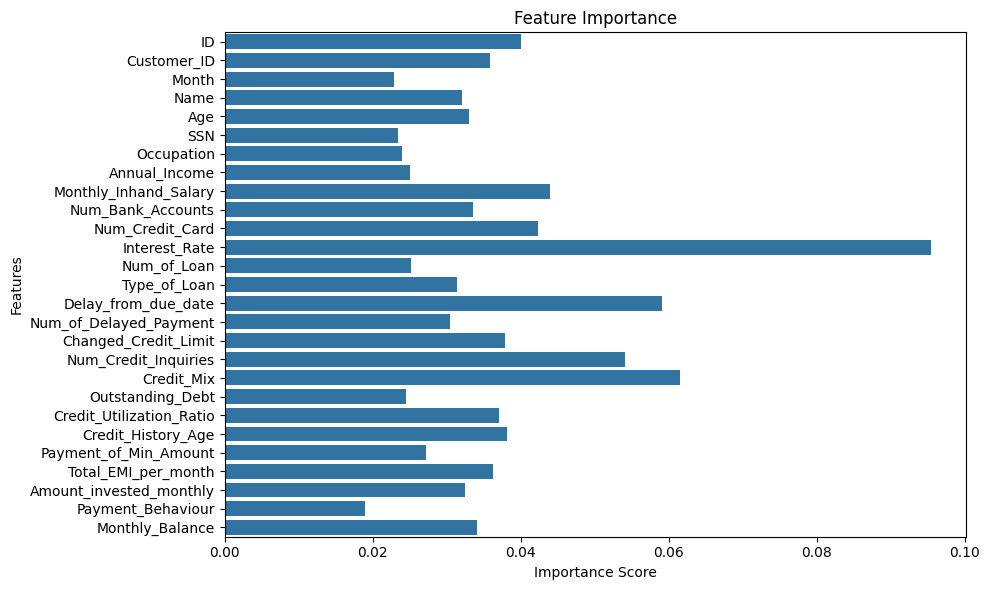

In [53]:
import matplotlib.pyplot as plt
import seaborn as sns

# Get feature importances
importances = clf.feature_importances_
features = X_train.columns

# Plot
plt.figure(figsize=(10, 6))
sns.barplot(x=importances, y=features)
plt.title("Feature Importance")
plt.xlabel("Importance Score")
plt.ylabel("Features")
plt.tight_layout()
plt.show()


In [55]:
!pip install plotly
import pandas as pd

# Count each category in predictions
category_counts = output_df['Predicted_Credit_Score'].value_counts().to_dict()

# Print counts
print(category_counts)


{'Standard': 27523, 'Poor': 13311, 'Good': 9166}


In [57]:
# Pick one row to visualize (you can choose any)
sample_prediction = output_df.iloc[0]['Predicted_Credit_Score']
import plotly.graph_objects as go

# Updated score mapping for range 0–1000
score_mapping = {
    "Poor": 200,
    "Standard": 500,
    "Good": 800
}

# Example prediction
sample_prediction = "Good"  # or use: output_df.iloc[0]['Predicted_Credit_Score']

fig = go.Figure(go.Indicator(
    mode="gauge+number+delta",
    value=score_mapping[sample_prediction],
    title={'text': f"Predicted Credit Score: {sample_prediction}"},
    gauge={
        'axis': {'range': [0, 1000]},
        'bar': {'color': "black"},
        'steps': [
            {'range': [0, 400], 'color': "red"},
            {'range': [400, 700], 'color': "yellow"},
            {'range': [700, 1000], 'color': "green"}
        ],
        'threshold': {
            'line': {'color': "blue", 'width': 4},
            'thickness': 0.75,
            'value': score_mapping[sample_prediction]
        }
    }
))

fig.show()
